# Human islets - Alpha cell heterogeneity

In [1]:
import scanpy as sc
import matplotlib.pyplot as pl
import numpy as np
import pandas as pd
import seaborn as sns
import xlsxwriter
import gseapy as gp
sc.settings.verbosity = 2
sc.logging.print_header()

scanpy==1.6.0 anndata==0.7.8 umap==0.4.5 numpy==1.21.2 scipy==1.5.4 pandas==1.3.5 scikit-learn==0.22 statsmodels==0.13.2 python-igraph==0.8.0 louvain==0.7.0 leidenalg==0.7.0


In [2]:
sc.set_figure_params(frameon=False, dpi_save=300, color_map='Reds')

## Manifold alpha cells

In [3]:
adata_endo = sc.read('../data/human_processed.h5ad')

In [ ]:
# remove raw counts to decrease memory
del adata_endo.raw

In [ ]:
adata_endo = adata_endo[:, ~adata_endo.var.feature_is_filtered].copy()

In [7]:
adata_alpha = adata_endo[adata_endo.obs['louvain_anno_broad'].isin(['alpha'])].copy()

In [8]:
sc.pp.filter_genes(adata_alpha, min_cells=10)

filtered out 1726 genes that are detected in less than 10 cells


In [9]:
sc.pp.highly_variable_genes(adata_alpha, n_top_genes=2000)

If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes
    finished (0:00:02)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


In [10]:
sc.pp.pca(adata_alpha)
sc.pp.neighbors(adata_alpha)
sc.tl.umap(adata_alpha)

computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:09)
computing neighbors
    using 'X_pca' with n_pcs = 50


/Users/stritschler/code/miniconda3/lib/python3.7/site-packages/numba/np/ufunc/parallel.py:355: NumbaWarning: The TBB threading layer requires TBB version 2019.5 or later i.e., TBB_INTERFACE_VERSION >= 11005. Found TBB_INTERFACE_VERSION = 11000. The TBB threading layer is disabled.
  warnings.warn(problem)


    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:11)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:08)


In [11]:
sc.tl.louvain(adata_alpha, resolution=0.9)

running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 8 clusters and added
    'louvain', the cluster labels (adata.obs, categorical) (0:00:01)


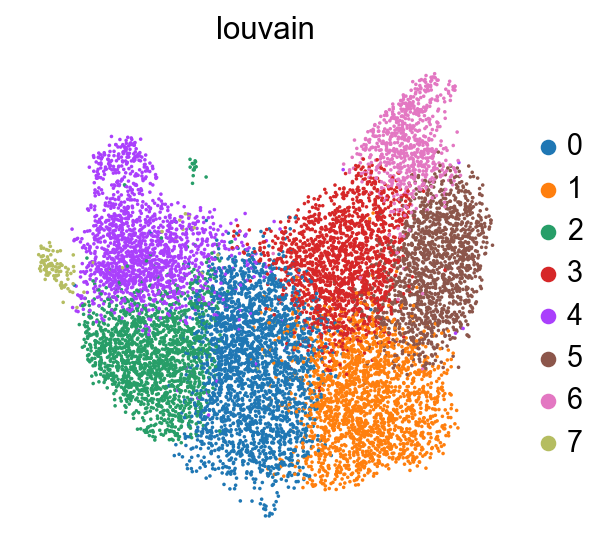

In [66]:
sc.pl.umap(adata_alpha,color=['louvain'])

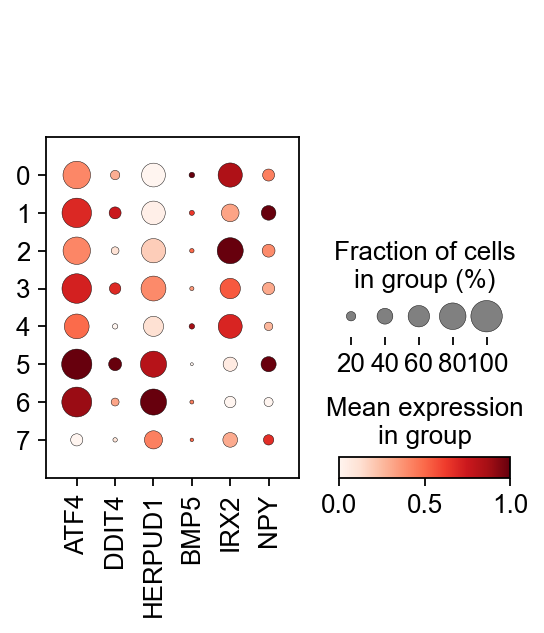

In [13]:
sc.pl.dotplot(adata_alpha, var_names=['ATF4', 'DDIT4', 'HERPUD1', 'BMP5', 'IRX2', 'NPY'], groupby='louvain', standard_scale='var')

In [15]:
map_names = {}
for c in adata_alpha.obs['louvain'].cat.categories:
    if c in ['0', '2', '4']:
        map_names[c] = 'mature'
    elif c in ['1']:
        map_names[c] = 'immature'
    elif c in ['5','6', '3']:
        map_names[c] = 'stress II'
    elif c in ['7']:
        map_names[c] = 'MHC'       

adata_alpha.obs['louvain_anno_fine'] = adata_alpha.obs['louvain']
adata_alpha.obs['louvain_anno_fine'] = adata_alpha.obs['louvain_anno_fine'].map(map_names).astype('category')
adata_alpha.uns['louvain_anno_fine_colors'] = ['#fdb462', '#80b1d3',  '#bebada', '#fb8072']
adata_alpha.obs['louvain_anno_fine'].cat.reorder_categories(['mature', 'immature', 'stress II', 'MHC'], inplace=True)

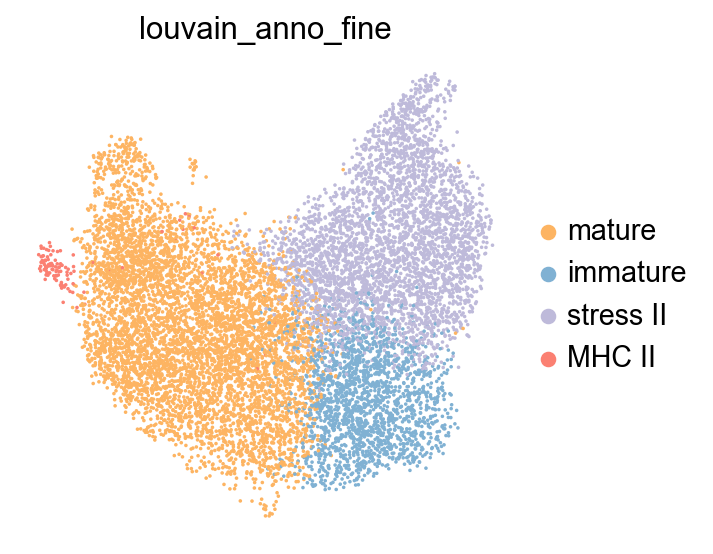

In [6]:
sc.pl.umap(adata_alpha, color=['louvain_anno_fine'])

### save adata

In [ ]:
adata_alpha.write('./data/adata_human_alpha.h5ad')

adata generated in human_islets_new_clustering.ipynb

In [3]:
#adata_alpha = sc.read('./data/adata_human_alpha.h5ad')

## Donor Composition

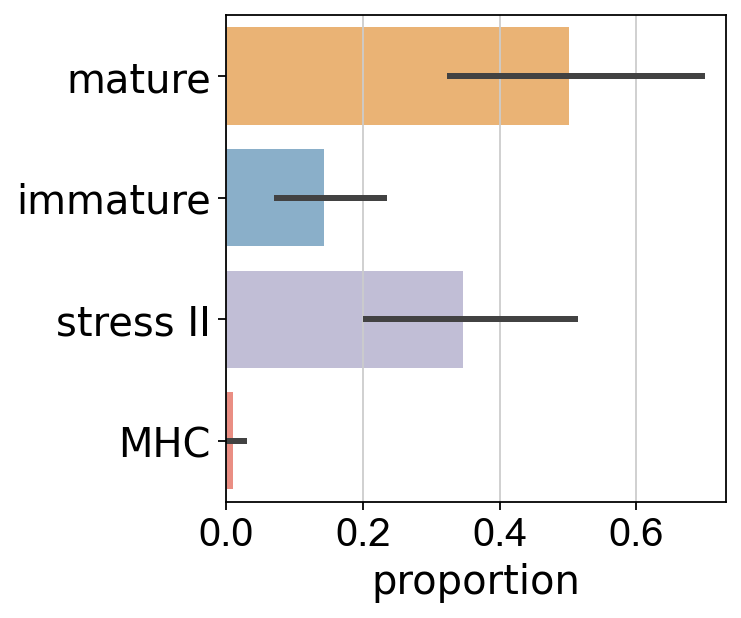

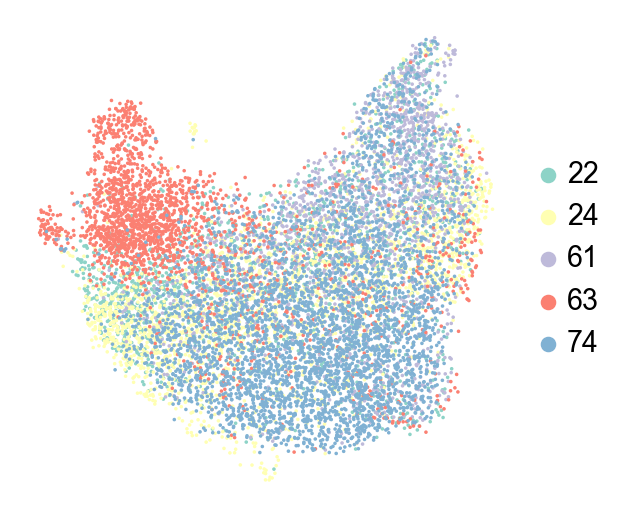

In [245]:
df = adata_alpha.obs[['louvain_anno_fine','donor']]

pl.subplots()
x='louvain_anno_fine'
hue='donor'
y='proportion'
prop_df = (df[x]
            .groupby(df[hue])
            .value_counts(normalize=True)
            .rename(y)
            .reset_index())

sns.barplot(x=y, y=x, data=prop_df,palette=adata_alpha.uns['louvain_anno_fine_colors'],orient='h', order=adata_alpha.obs.louvain_anno_fine.cat.categories)
pl.xticks(rotation=0,fontsize=18)
pl.yticks(rotation=0,fontsize=18,fontname='Helvetica Light')
pl.ylabel('')
pl.xlabel('proportion',fontsize=18,fontname='Helvetica Light')
pl.show()
sc.pl.umap(adata_alpha, color=['donor'],title='',save='alpha_donors.pdf')

In [247]:
prop_df.groupby('louvain_anno_fine').mean()

,proportion
louvain_anno_fine,
mature,0.501027
immature,0.142830
stress II,0.346075
MHC,0.010068


In [53]:
sc.tl.embedding_density(adata_alpha, groupby='donor', basis='umap')

/Users/stritschler/code/miniconda3/lib/python3.7/site-packages/scanpy/plotting/_tools/__init__.py:1156: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("YlOrRd"))
  color_map.set_over('black')
/Users/stritschler/code/miniconda3/lib/python3.7/site-packages/scanpy/plotting/_tools/__init__.py:1157: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("YlOrRd"))
  color_map.set_under('lightgray')
/Users/stritschler/code/miniconda3/lib/python3.7/site-packages/scanpy/plotting/_tools/scatterplots.py:400: MatplotlibDeprecationWarning: Passing paramete

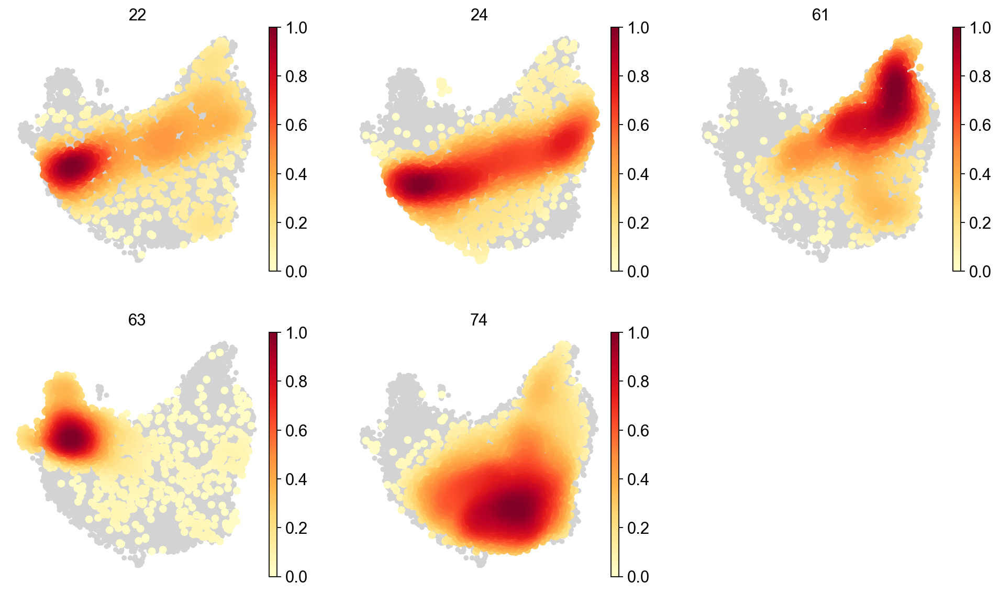

In [54]:
sc.pl.embedding_density(adata_alpha, basis='umap', key='umap_density_donor', ncols=3)

## Identity and functional marker expression

### Identity and maturity

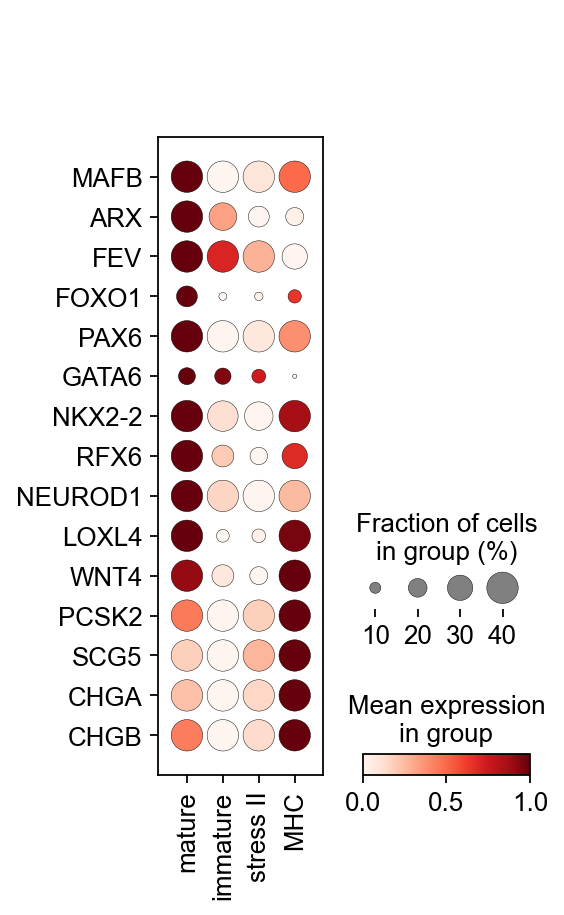

In [370]:
sc.pl.dotplot(adata_alpha, groupby='louvain_anno_fine',
              var_names=['MAFB', 'ARX', 'FEV', 'FOXO1', 'PAX6', 'GATA6', 'NKX2-2', 'RFX6', 'NEUROD1', 'LOXL4', 'WNT4', 'PCSK2', 'SCG5', 'CHGA', 'CHGB'], 
              standard_scale='var', dot_max=0.4, swap_axes=True)

### Hormone secretion and ion channels

In [444]:
glucagon_sec = {'glucose transport/\nprocessing': ['SLC2A1', 'SLC2A3', 'GCK'], 
                'hormone receptor': ['INSR', 'GIPR', 'SSTR1', 'SSTR2'],
                'Zn transporter': ['SLC30A8'],
                'GABA receptor': ['GABRG2', 'GABRB3'],
               'secretory\ngranules': ['SYT7', 'RAB27A', 'RAB3A', 'SNAP25', 'STX1A', 'STXBP1', 'CDC42', 'UNC13A', 'VAMP2', 'AP3B1'],
                'K+ channel': ['KCNJ11', 'KCNJ8', 'KCNJ6', 'ABCC8', 'ABCC9'],
               'Ca2+ channel':['CACNA1A', 'CACNA2D1', 'CACNA2D2', 'CACNA1C', 'CACNA1D', 'CACNA1H', 'CACNG4'],
               'Na+ channel':['SCN1B', 'SCN3A', 'SCN3B', 'SCN9A'], 
               }

In [445]:
genes = []
for k,v in glucagon_sec.items():
    genes = genes + v

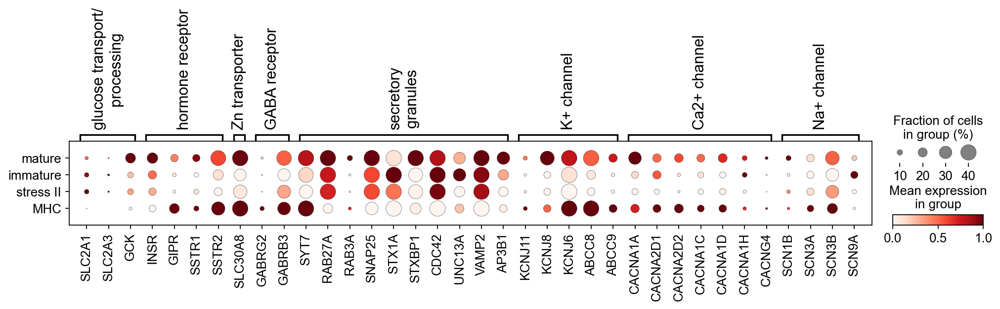

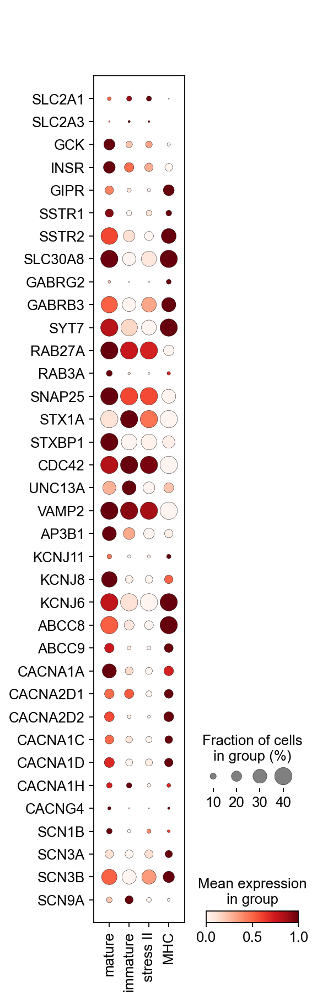

In [446]:
sc.pl.dotplot(adata_alpha,groupby='louvain_anno_fine',
              var_names = glucagon_sec,
              standard_scale='var', dot_max=0.4)
sc.pl.dotplot(adata_alpha,groupby='louvain_anno_fine',
              var_names = genes,
              standard_scale='var', dot_max=0.4, swap_axes=True)

In [323]:
adata_alpha_2 = adata_alpha.copy()
sc.pp.filter_genes(adata_alpha_2, min_cells=100)

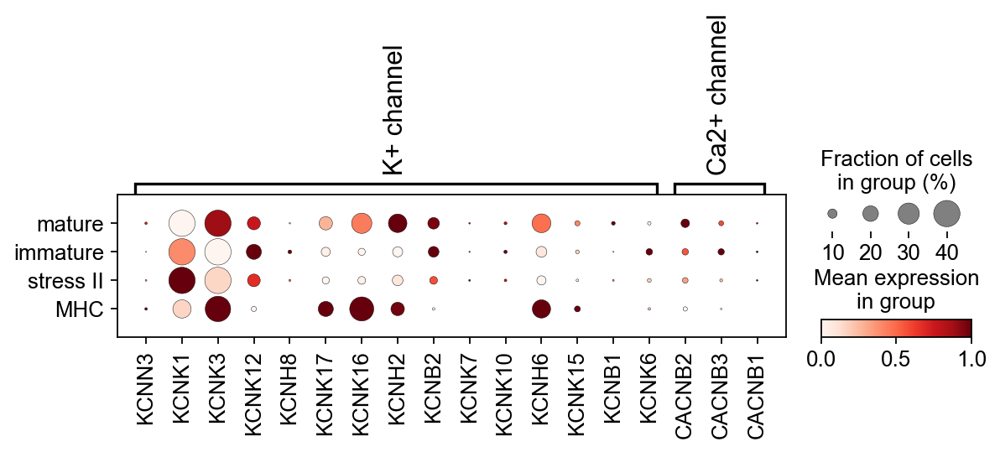

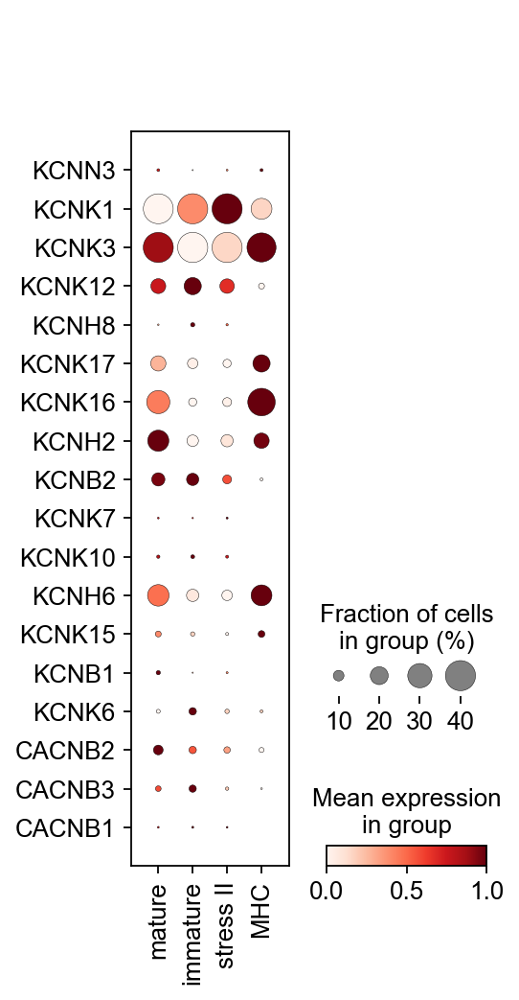

In [352]:
ion_channels = {'K+ channel': [gene for gene in adata_alpha_2.var_names if (gene.startswith('KCNB')) | (gene.startswith('KCNK')) | (gene.startswith('KCNH')) | (gene.startswith('KCNN')) | (gene.startswith('KCNE'))],
                'Ca2+ channel': [gene for gene in adata_alpha_2.var_names if (gene.startswith('CACNB'))]}

genes = []
for k,v in ion_channels.items():
    genes = genes + v

sc.pl.dotplot(adata_alpha,groupby='louvain_anno_fine',
              var_names = ion_channels,
              standard_scale='var', dot_max=0.4)
sc.pl.dotplot(adata_alpha,groupby='louvain_anno_fine',
              var_names = genes,
              standard_scale='var', dot_max=0.4, swap_axes=True)

### Stress response pathways

In [479]:
stress_dict = {'IRE': ['ERN1','TRAF2','MAP3K5','JUN'],
              'PERK': ['EIF2AK3','EIF2A','ATF4','DDIT3','PPP1R15A','PPP1CC'],
              'ATF6': ['ATF6','XBP1','HSPA5'], 
              'ATF3': ['ATF3'], 
              'ERAD': ['HERPUD1', 'SDF2L1', 'DERL2', 'SYVN1', 'EDEM1']}

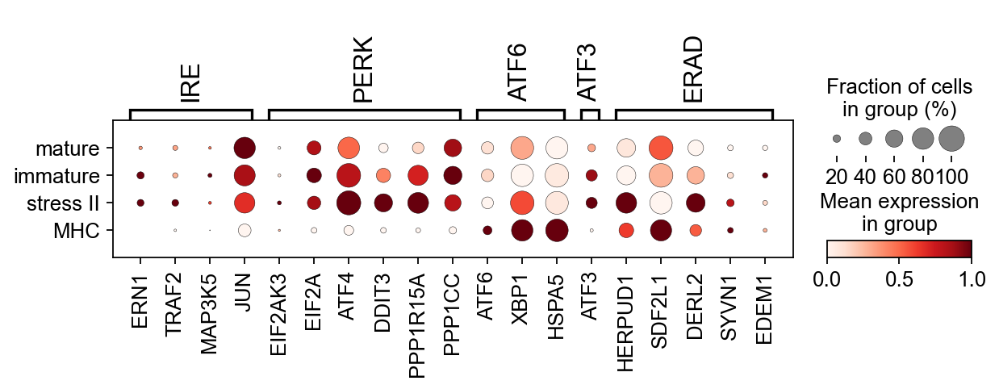

In [480]:
sc.pl.dotplot(adata_alpha, groupby='louvain_anno_fine', var_group_rotation=90,
              var_names=stress_dict, standard_scale='var')

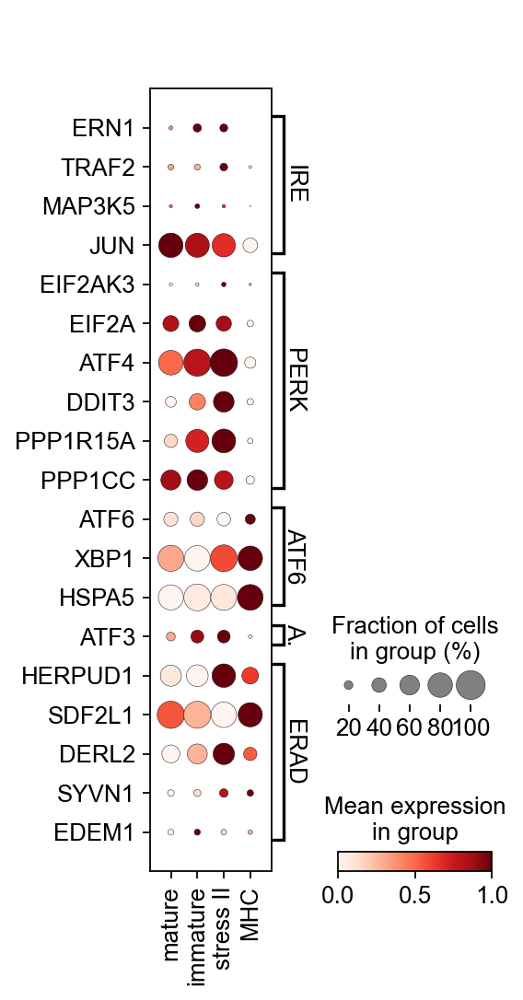

In [481]:
sc.pl.dotplot(adata_alpha, groupby='louvain_anno_fine', 
              var_names=stress_dict, standard_scale='var', swap_axes=True)

### Immature state profile

In [412]:
gc_dict = {'cell adhesion': ['ITGA2', 'ITGA6', 'ITGB6', 'LAMA3', 'LAMB3', 'LAMC1', 'LAMC2', 'FLRT2'],
           'cytokines': ['LIF', 'LIFR', 'TSLP', 'IL11', 'IL15', 'CXCL1', 'CXCL2'],
           'interferone response': ['IFIT3', 'IFI16', 'GBP1', 'GBP2', 'GBP3'],
           'other markers': ['SGK1', 'SHC4', 'PHLDA1', 'PHLDA2', 'LUCAT1']}

In [413]:
genes = []
for k,v in gc_dict.items():
    genes = genes + v

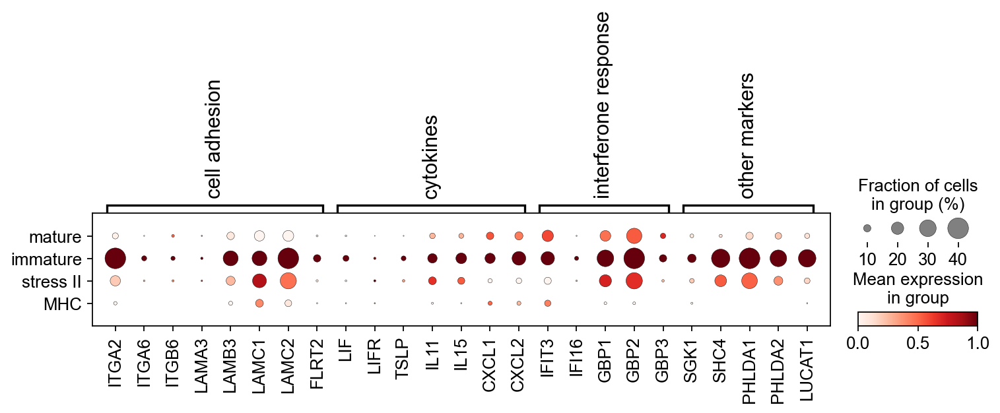

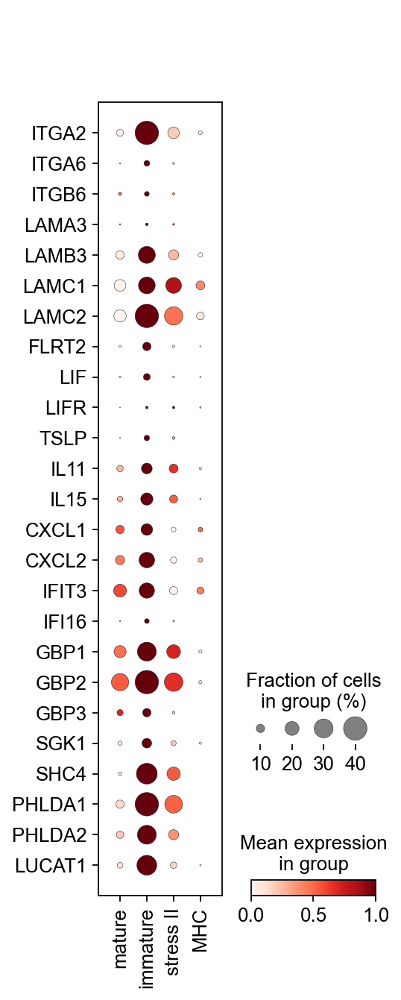

In [414]:
sc.pl.dotplot(adata_alpha,groupby='louvain_anno_fine',
              var_names = gc_dict,
              standard_scale='var', dot_max=0.4)
sc.pl.dotplot(adata_alpha,groupby='louvain_anno_fine',
              var_names = genes,
              standard_scale='var', dot_max=0.4, swap_axes=True)

In [415]:
gc_dict = {'developmental\nfactors': ['WNT2', 'SOX4', 'SOX11', 'NRG1', 'EPHB2',  'EPHB6', 'SPOCK1'],
            'growth factors/\nhormones': ['VEGFC', 'IGF2BP2', 'IGF2', 'NPY'],
            'TGFB\nsignaling': ['TGFBR1', 'TGFBR2', 'TGFB1', 'SMAD3', 'SMAD5', 'SMAD7', 'SMAD9', 'SOCS3', 
                    'ID1', 'ID2', 'ID3', 'TNC', 'MET', 'MYC', 'CDH6', 'BMP2', 'BMP8B', 'BMP5']}


In [416]:
genes = []
for k,v in gc_dict.items():
    genes = genes + v

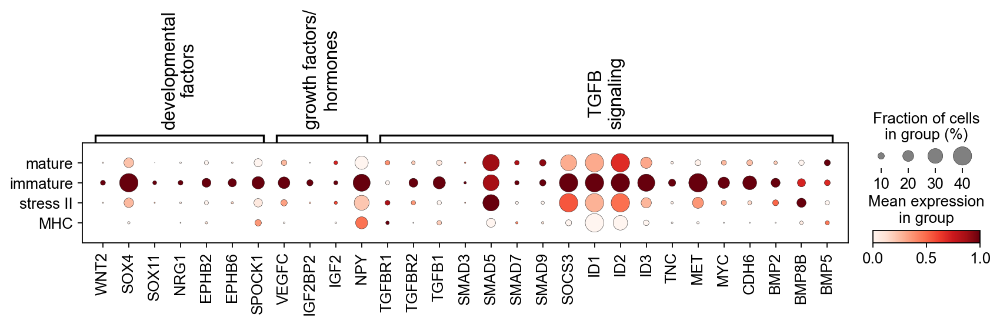

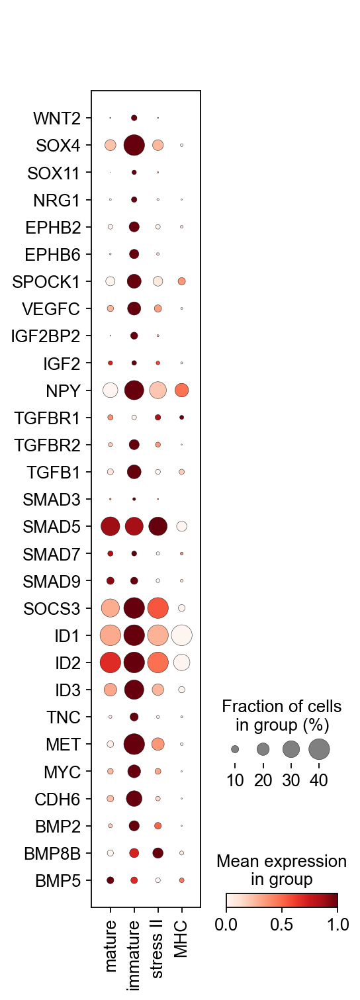

In [417]:
sc.pl.dotplot(adata_alpha,groupby='louvain_anno_fine',
              var_names = gc_dict,
              standard_scale='var', dot_max=0.4)
sc.pl.dotplot(adata_alpha,groupby='louvain_anno_fine',
              var_names = genes,
              standard_scale='var', dot_max=0.4, swap_axes=True)

## Gene sets

In [8]:
adata_alpha_2 = adata_alpha.copy()
sc.pp.filter_genes(adata_alpha_2, min_cells=20)

filtered out 1293 genes that are detected in less than 20 cells


In [9]:
sc.pp.highly_variable_genes(adata_alpha_2, n_top_genes=3000)

If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes
    finished (0:00:03)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


In [10]:
adata_alpha_hvg = adata_alpha_2[:,adata_alpha_2.var.highly_variable].copy()

In [11]:
del adata_alpha_2

In [12]:
df = adata_alpha_hvg.to_df().T

In [13]:
df_corr = np.corrcoef(df)

In [14]:
from scipy.spatial import distance
from scipy.cluster import hierarchy

dist = distance.pdist(df_corr, metric='euclidean')
row_linkage = hierarchy.linkage(dist, method='ward')

In [28]:
clusters = hierarchy.fcluster(row_linkage, 0.85*dist.max(), 'distance')
np.unique(clusters)

array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14],
      dtype=int32)

In [29]:
df_corr = pd.DataFrame(df_corr)

/Users/stritschler/code/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:15: UserWarning: Use the colorbar set_ticks() method instead.
  from ipykernel import kernelapp as app
/Users/stritschler/code/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:16: UserWarning: Use the colorbar set_ticks() method instead.
  app.launch_new_instance()


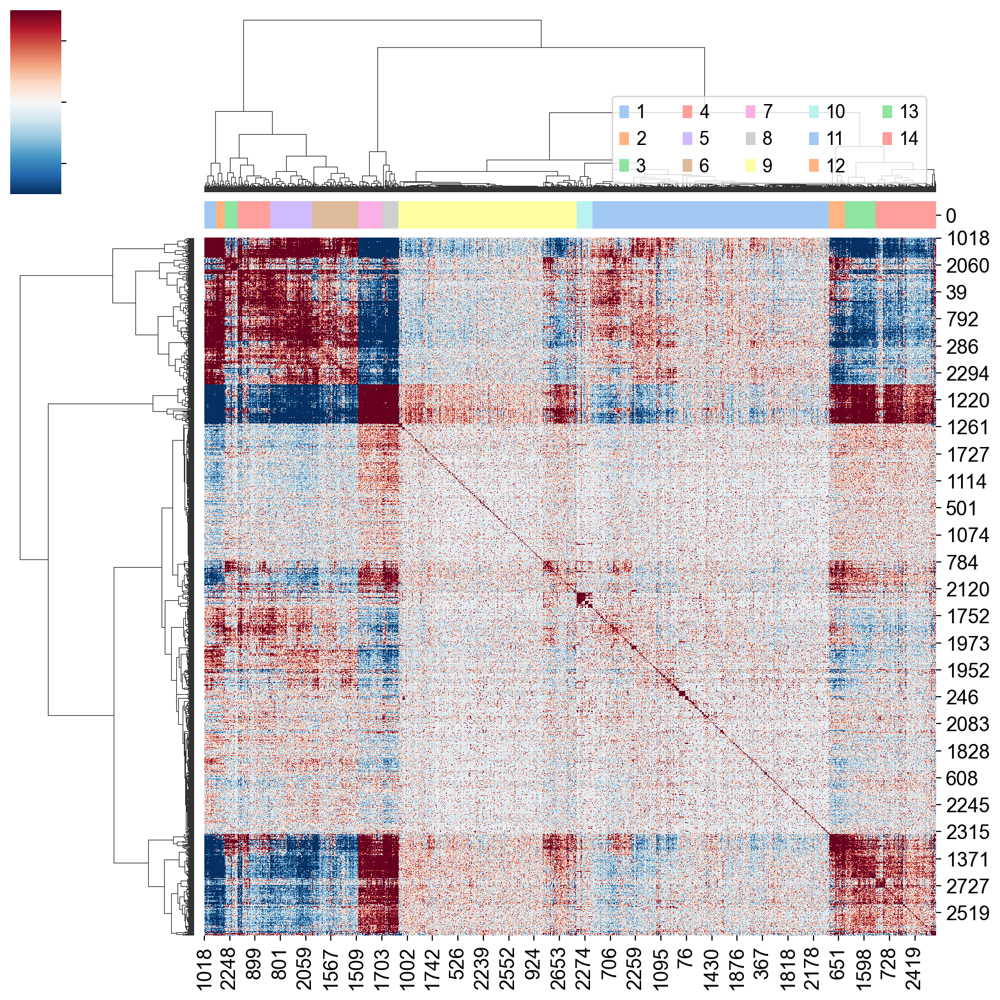

In [30]:
# =set colors for heatmap
col_dict = dict(zip(set(clusters), sns.color_palette('pastel', n_colors=len(np.unique(clusters)))))
col_colors = pd.DataFrame(clusters, index=df_corr.index)[0].map(col_dict)

g = sns.clustermap(df_corr, row_linkage=row_linkage, col_linkage=row_linkage, 
               col_colors=col_colors,
               cmap='RdBu_r', vmin=-0.03, vmax=0.03)

for label in col_dict.keys():
    g.ax_col_dendrogram.bar(0, 0, color=col_dict[label],
                            label=label, linewidth=0)
    
g.cax.set_xticklabels([])
g.cax.set_yticklabels([])
g.cax.set_xticks([])
g.cax.set_yticks([])


g.ax_col_dendrogram.legend(loc="lower right", ncol=5)

### Correlation mean

In [194]:
df_corr.index = adata_alpha_hvg.var_names

In [195]:
df_corr.index = adata_alpha_hvg.var_names
df_corr.columns = adata_alpha_hvg.var_names
df_corr['gene set'] = [f'G{clu}' for clu in clusters]
df_corr_gr = df_corr.groupby(['gene set']).mean().T
df_corr_gr['gene set'] = [f'G{clu}' for clu in clusters]

In [196]:
df_corr_gr_mean = df_corr_gr.groupby(['gene set']).mean()

In [197]:
df_corr_gr_mean = df_corr_gr_mean.loc[['G1', 'G2', 'G3', 'G4', 'G5', 'G6', 'G7', 'G8', 'G9', 'G10', 'G11', 'G12', 'G13', 'G14'], 
                                      ['G1', 'G2', 'G3', 'G4', 'G5', 'G6', 'G7', 'G8', 'G9', 'G10', 'G11', 'G12', 'G13', 'G14']]

In [198]:
df_diag = pd.DataFrame(np.diag(df_corr_gr_mean), index = df_corr_gr_mean.index)

In [199]:
df_diag.style.background_gradient(cmap='coolwarm', axis=1, vmin=-0.15, vmax=0.15).format('{:.2g}')

,0
gene set,
G1,0.19
G2,0.22
G3,0.1
G4,0.06
G5,0.053
G6,0.027
G7,0.094
G8,0.23
G9,0.0027


### save

In [212]:
workbook = xlsxwriter.Workbook('./output_files/gene_sets_alpha.xlsx')

worksheet = workbook.add_worksheet()

row = 0
col = 0

for key in range(1,len(np.unique(clusters))+1):
    row = 0
    worksheet.write(row, col, key)
    for item in adata_alpha_hvg.var_names[clusters==key].tolist():
        worksheet.write(row+1, col, item)
        row += 1
    col += 1
workbook.close()

### enrich

In [8]:
df_gene_set = pd.read_excel('./output_files/gene_sets_alpha.xlsx')

In [10]:
enr_dict_go = {}

for i in df_gene_set.columns:
    genes = df_gene_set[i].dropna().tolist()
    enr = gp.enrichr(gene_list=genes, gene_sets='GO_Biological_Process_2018', organism='human')
    enr_dict_go[str(i)]=enr.res2d   

2022-02-06 19:50:43,966 Warning: No enrich terms using library GO_Biological_Process_2018 when cutoff = 0.05
2022-02-06 19:51:05,046 Warning: No enrich terms using library GO_Biological_Process_2018 when cutoff = 0.05
2022-02-06 19:51:10,054 Warning: No enrich terms using library GO_Biological_Process_2018 when cutoff = 0.05


/Users/stritschler/code/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:11: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  # This is added back by InteractiveShellApp.init_path()


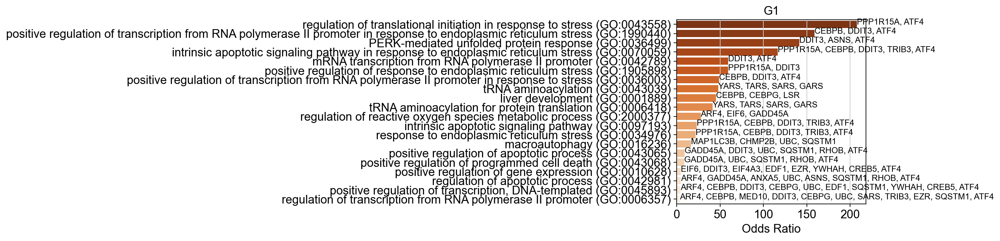

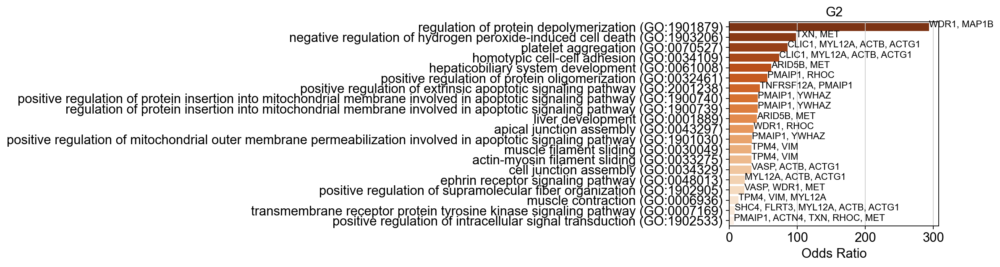

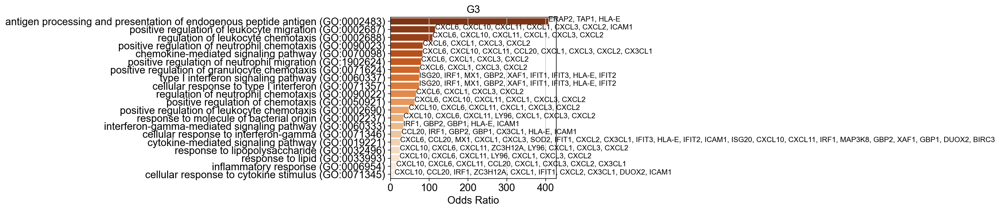

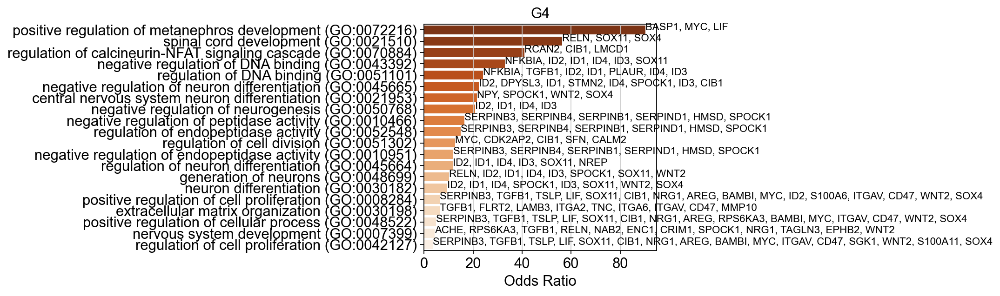

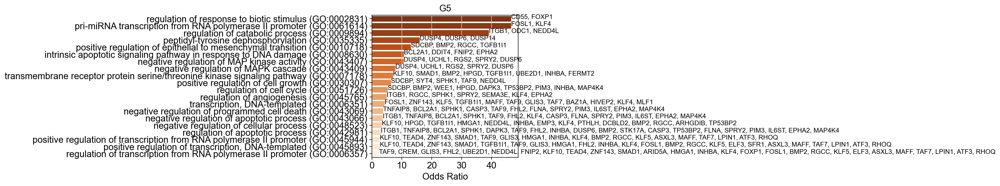

...

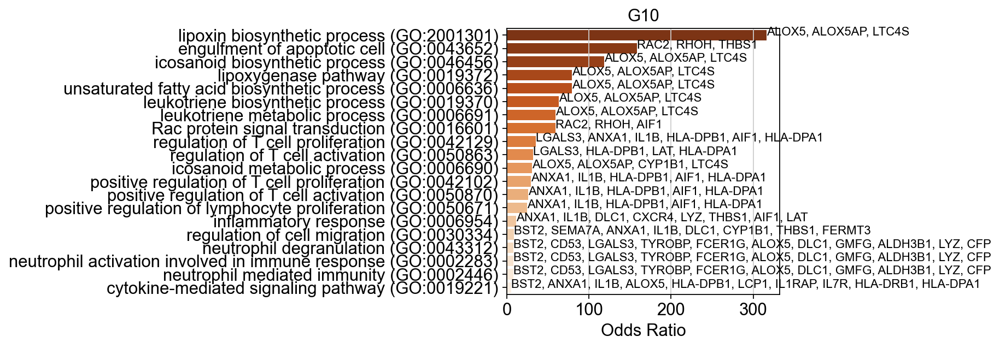

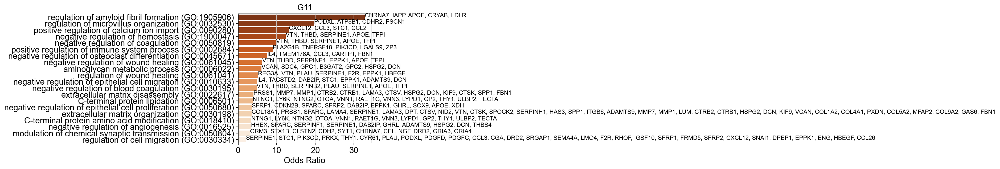

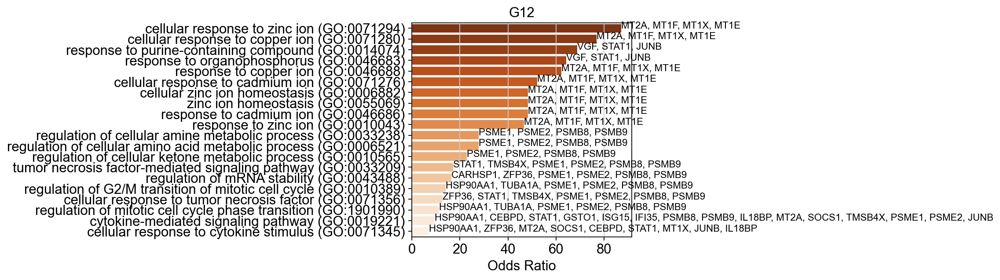

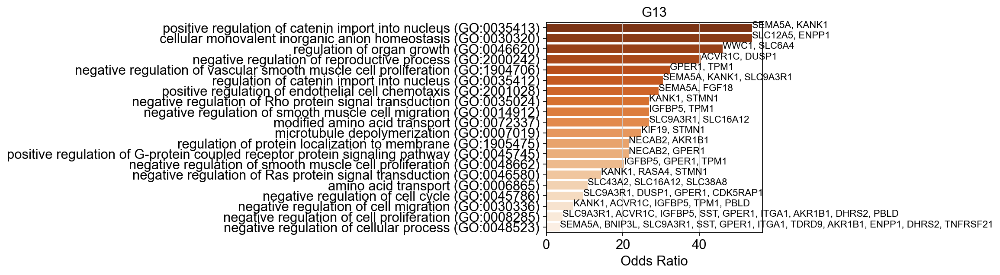

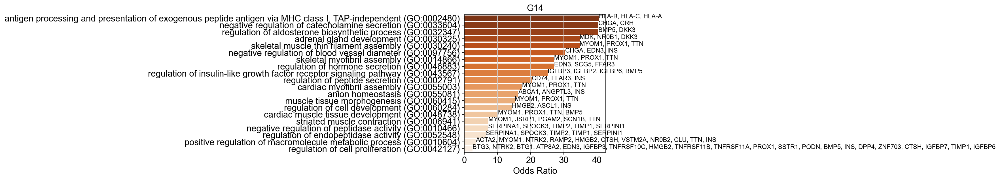

In [11]:
for key in enr_dict_go.keys():
    fig,axs = pl.subplots()
    sns.barplot(data=enr_dict_go[key].head(20).sort_values(by='Odds Ratio', ascending=False),
                y='Term', x='Odds Ratio', orient='horizontal', palette='Oranges_r', ax=axs)
    i=0
    for index, row in enr_dict_go[key].head(20).sort_values(by='Odds Ratio', ascending=False).iterrows():
        axs.text(row['Odds Ratio'], i, row.Genes.replace(';', ', '), color='black', ha="left", fontsize=10)
        i+=1
    pl.ylabel('')
    pl.title(f'G{key}')
    pl.tight_layout()

In [12]:
enr_dict_kegg = {}
for i in df_gene_set.columns:
    genes = df_gene_set[i].dropna().tolist()
    enr = gp.enrichr(gene_list=genes, gene_sets='KEGG_2019_Human', organism='human')
    enr_dict_kegg[str(i)]=enr.res2d

2022-02-06 19:51:38,858 Warning: No enrich terms using library KEGG_2019_Human when cutoff = 0.05
2022-02-06 19:51:50,961 Warning: No enrich terms using library KEGG_2019_Human when cutoff = 0.05
2022-02-06 19:51:56,421 Warning: No enrich terms using library KEGG_2019_Human when cutoff = 0.05
2022-02-06 19:52:18,827 Warning: No enrich terms using library KEGG_2019_Human when cutoff = 0.05


/Users/stritschler/code/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:12: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  if sys.path[0] == '':


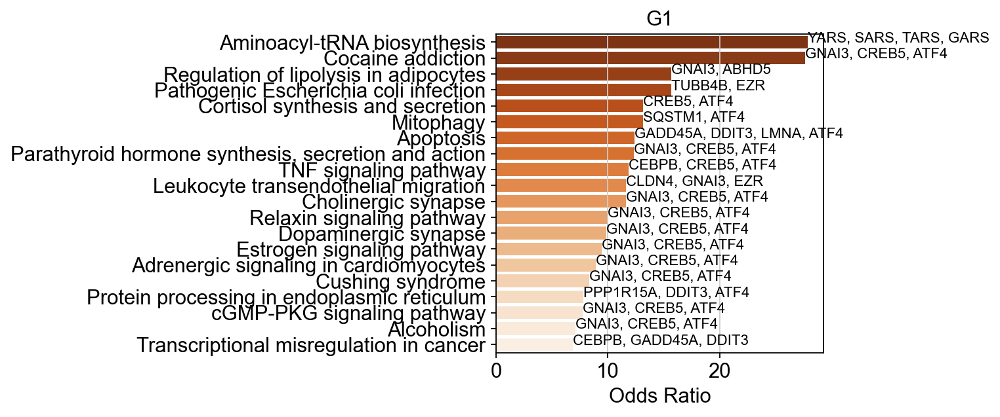

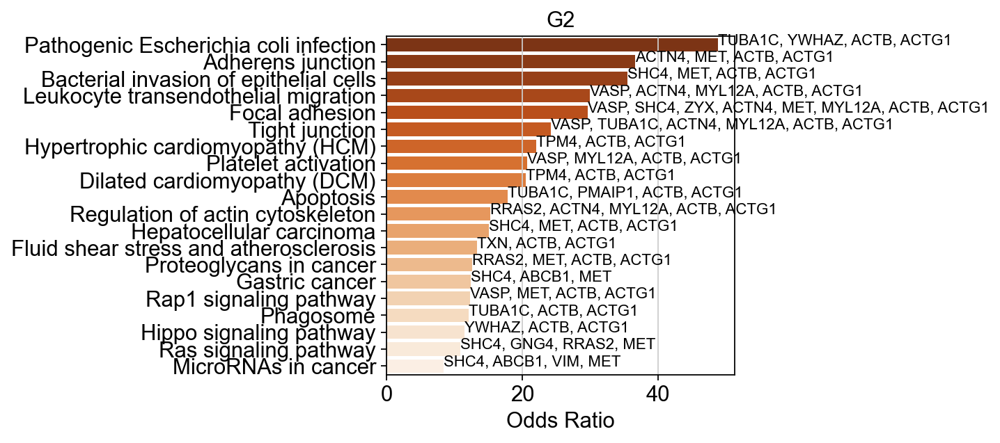

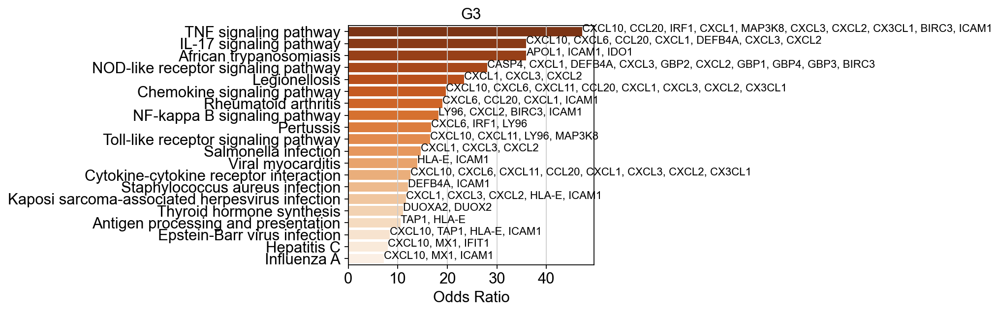

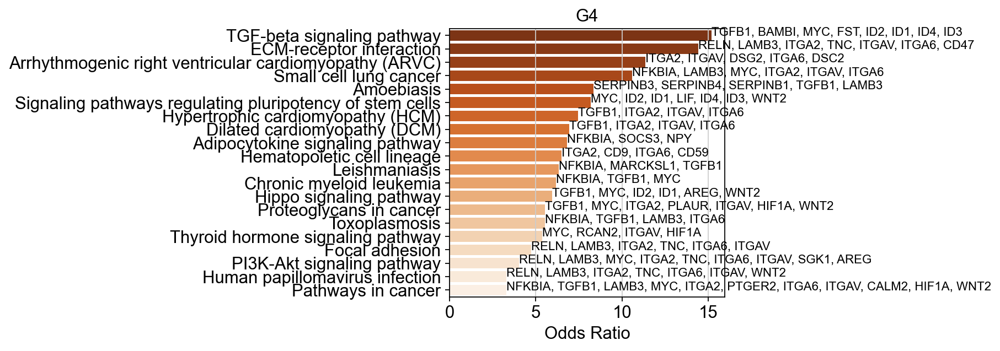

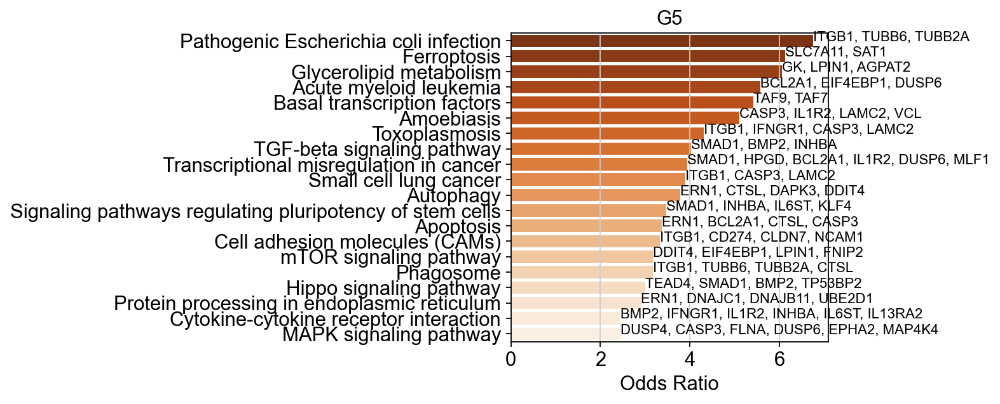

...

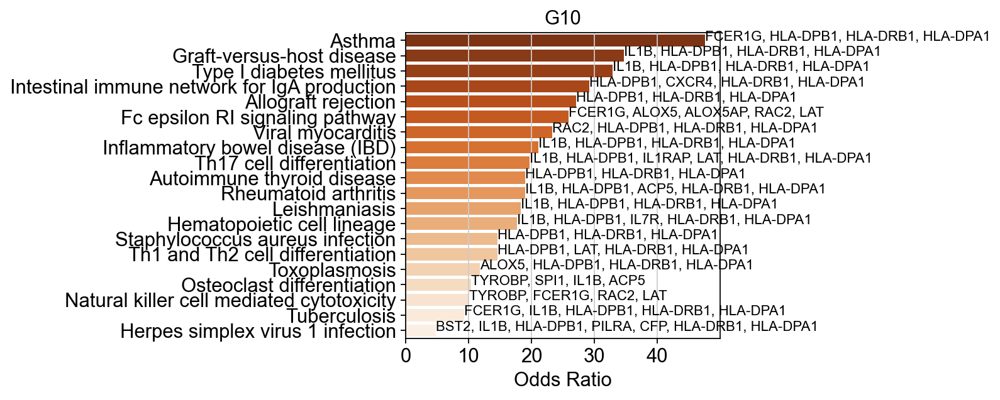

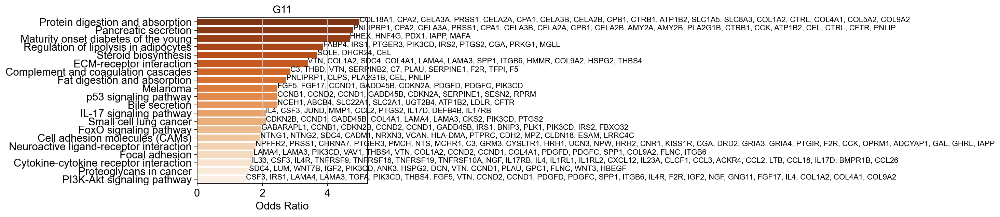

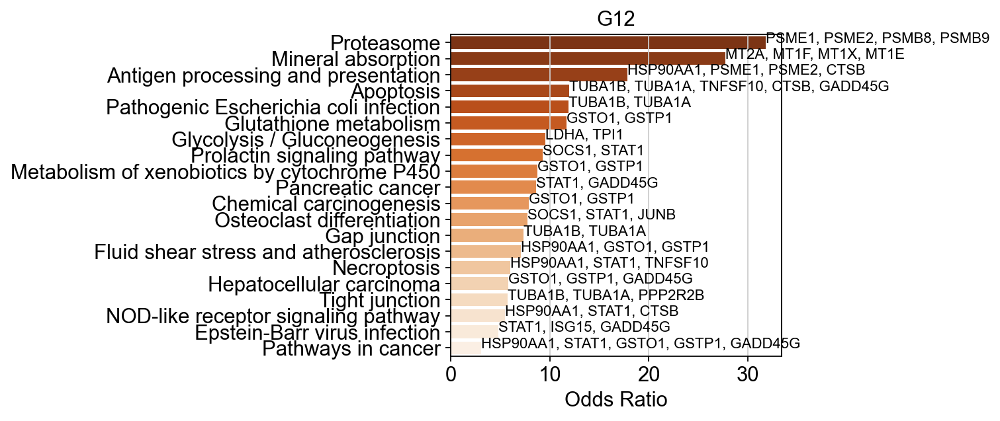

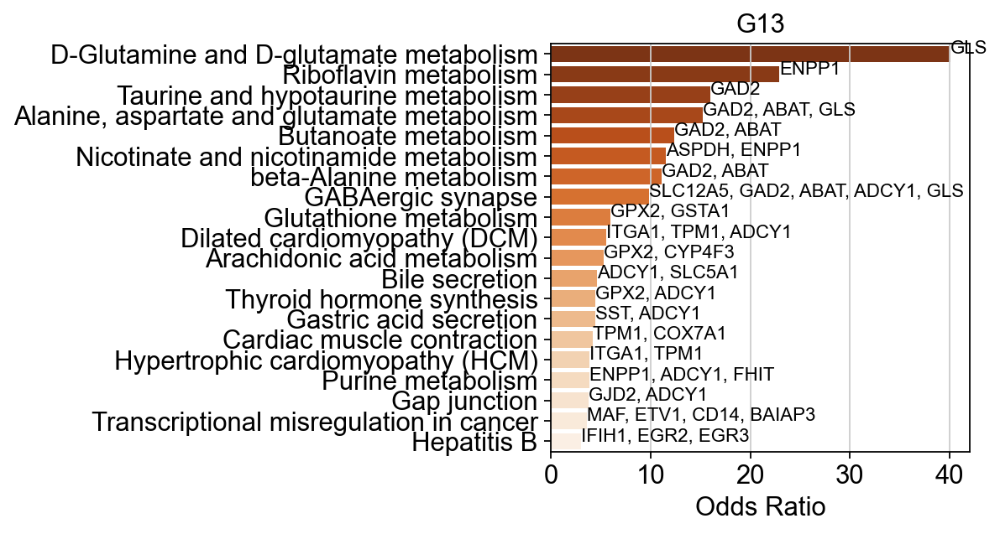

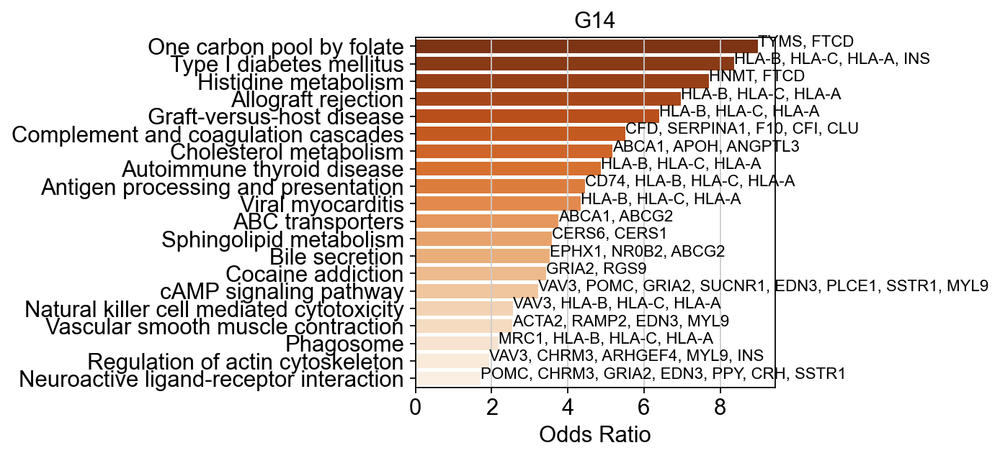

In [52]:
for key in enr_dict_kegg.keys():
    fig,axs = pl.subplots()
    sns.barplot(data=enr_dict_kegg[key].head(20).sort_values(by='Odds Ratio', ascending=False),
                y='Term', x='Odds Ratio', orient='horizontal', palette='Oranges_r', ax=axs)

    i=0
    for index, row in enr_dict_kegg[key].head(20).sort_values(by='Odds Ratio', ascending=False).iterrows():
        axs.text(row['Odds Ratio'], i, row.Genes.replace(';', ', '), color='black', ha="left", fontsize=10)
        i+=1
    pl.ylabel('')
    pl.title(f'G{key}')
    pl.tight_layout()

### Save Supplementary Table 3

In [13]:
df = pd.DataFrame(index=df_gene_set.columns, columns=['gene set', 'genes', 'top 20 GO Biological Process 2018 terms', 'top 20 KEGG_2019_Human pathways'])

In [14]:
for i in df_gene_set.columns:
    df.loc[i, 'gene set'] = f'G{i}'
    df.loc[i, 'genes'] = df_gene_set[i].dropna().tolist()
    df.loc[i, 'top 20 GO Biological Process 2018 terms'] = enr_dict_go[str(i)].head(20).sort_values(by='Odds Ratio', ascending=False)['Term'].tolist()
    df.loc[i, 'top 20 KEGG_2019_Human pathways'] = enr_dict_kegg[str(i)].head(20).sort_values(by='Odds Ratio', ascending=False)['Term'].tolist()

In [15]:
df.to_excel('./Supplementary_table_3_alpha.xlsx')

### Scores

In [188]:
for i in range(1,len(np.unique(clusters))+1):
    sc.settings.verbosity=0
    genes = adata_alpha_hvg.var_names[clusters==i].tolist()
    sc.tl.score_genes(adata_alpha, gene_list=genes, score_name=f'G{i}')

In [151]:
gene_sets_all = pd.read_excel('./output_files/gene_sets_alpha.xlsx')

for i in gene_sets_all.columns:
    sc.settings.verbosity=0
    genes = gene_sets_all[i].dropna().tolist()
    sc.tl.score_genes(adata_alpha, gene_list=genes, score_name=f'G{i}')

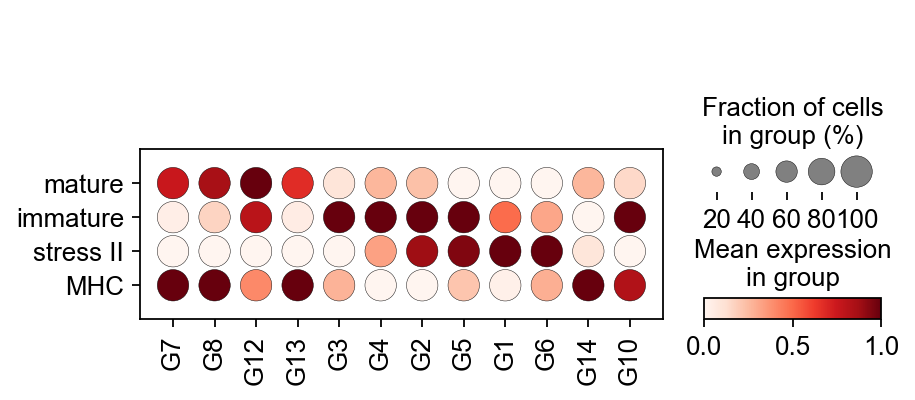

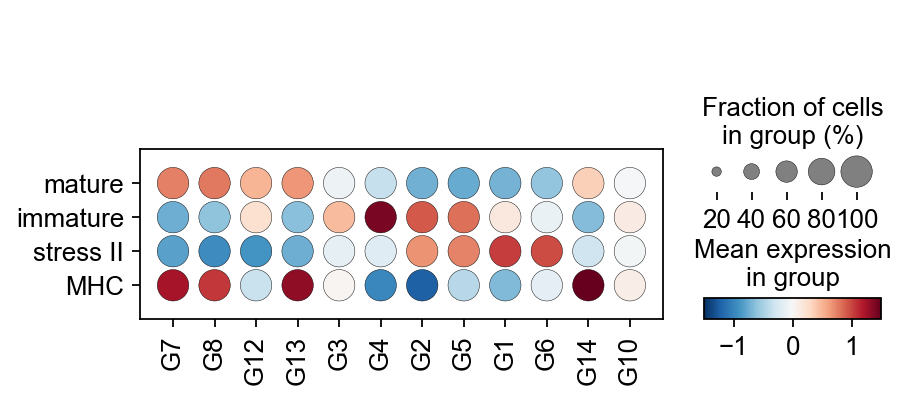

In [249]:
adata_alpha_g = sc.AnnData(adata_alpha.obs[['G7', 'G8', 'G12', 'G13', 'G3', 'G4', 'G2', 'G5', 'G1', 'G6', 'G14', 'G10']])
adata_alpha_g.obs = adata_alpha.obs
sc.pl.dotplot(adata_alpha_g, groupby='louvain_anno_fine', var_names=adata_alpha_g.var_names, standard_scale='var', dot_max=1, expression_cutoff=-0.5)
sc.pl.dotplot(sc.pp.scale(adata_alpha_g, copy=True), groupby='louvain_anno_fine', var_names=adata_alpha_g.var_names,  expression_cutoff=-3, vmax=1.5, vmin=-1.5, cmap='RdBu_r')

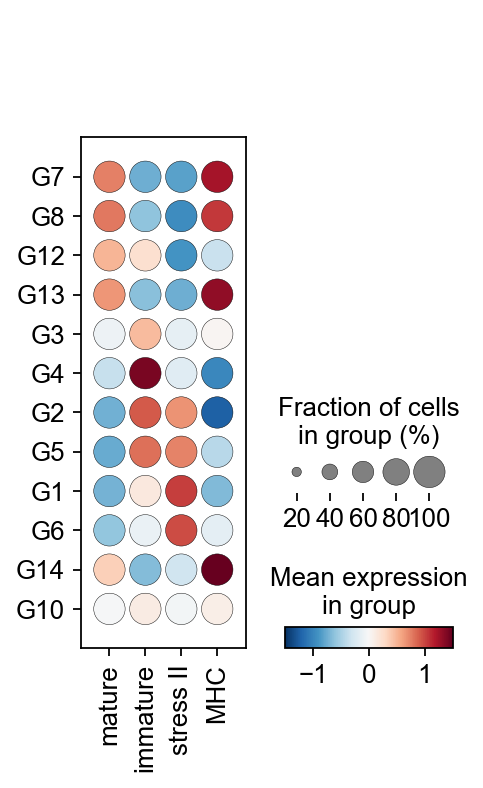

In [250]:
sc.pl.dotplot(sc.pp.scale(adata_alpha_g, copy=True), groupby='louvain_anno_fine', var_names=adata_alpha_g.var_names,  
              expression_cutoff=-3, vmax=1.5, vmin=-1.5, cmap='RdBu_r', swap_axes=True)

## Comparison to fetal alpha cells

### Cao 2020

data curated in curate_fetal_Cao_2020.ipynb

In [104]:
cao_fetal = sc.read('./data/cao_fetal_endo.h5ad')

In [105]:
sc.pp.filter_genes(cao_fetal, min_cells=10)

In [106]:
cao_fetal.obs.louvain_anno_broad.value_counts()

beta               1575
alpha               662
delta               607
epsilon             106
alpha precursos      94
Fev+ precursor       53
beta precursor       37
Name: louvain_anno_broad, dtype: int64

In [107]:
cao_fetal.obs.louvain_anno_broad.cat.rename_categories(['Fev+ precursor', 'alpha', 'alpha precursor', 'beta', 'beta precursor', 'delta', 'epsilon'], inplace=True)
cao_fetal.obs.louvain_anno_broad.cat.reorder_categories(['Fev+ precursor',  'beta precursor', 'beta', 'alpha precursor', 'alpha', 'delta', 'epsilon'], inplace=True)

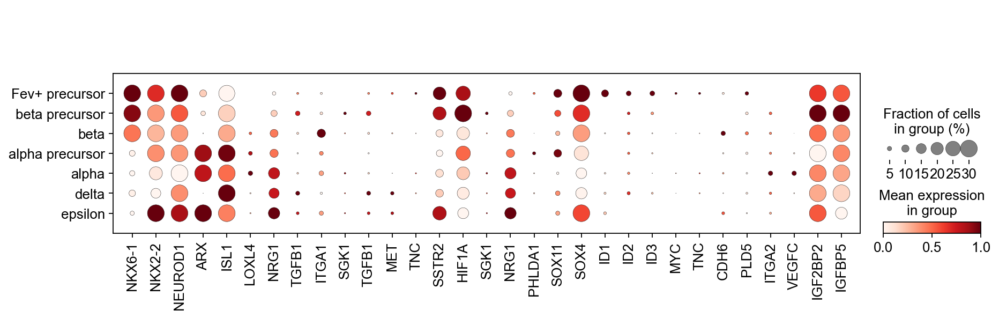

In [176]:
sc.pl.dotplot(cao_fetal, groupby='louvain_anno_broad',
                 var_names=['NKX6-1', 'NKX2-2', 'NEUROD1', 'ARX', 'ISL1', 'LOXL4', 'NRG1', 'TGFB1', 'ITGA1', 'SGK1', 'TGFB1', 'MET', 'TNC', 
                            'SSTR2', 'HIF1A', 'SGK1', 'NRG1', 'PHLDA1', 'SOX11', 'SOX4', 'ID1', 'ID2', 'ID3', 'MYC', 'TNC', 'CDH6', 'PLD5', 'ITGA2', 'VEGFC', 'IGF2BP2', 'IGFBP5'],dot_max=0.3,
                 standard_scale='var')

In [ ]:
for i in gene_sets_all.columns:
    sc.settings.verbosity=0
    genes = gene_sets_all[i].dropna().tolist()
    sc.tl.score_genes(cao_fetal, gene_list=genes, score_name=f'G{i}')

In [158]:
cao_fetal_alpha = cao_fetal[cao_fetal.obs.louvain_anno_broad.isin(['alpha', 'alpha precursor', 'Fev+ precursor'])].copy()

In [263]:
cao_fetal.uns['louvain_anno_broad_colors']

array(['#1f77b4', '#ff7f0e', '#279e68', '#d62728', '#aa40fc', '#8c564b',
       '#17becf'], dtype=object)

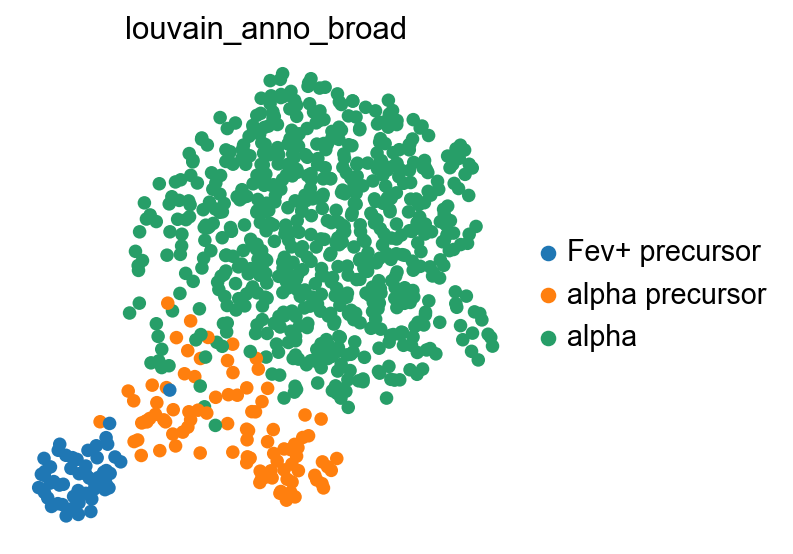

In [264]:
sc.pp.neighbors(cao_fetal_alpha)
sc.tl.umap(cao_fetal_alpha)
sc.pl.umap(cao_fetal_alpha, color=['louvain_anno_broad'], palette=['#1f77b4', '#ff7f0e', '#279e68'])

### Gene set scores

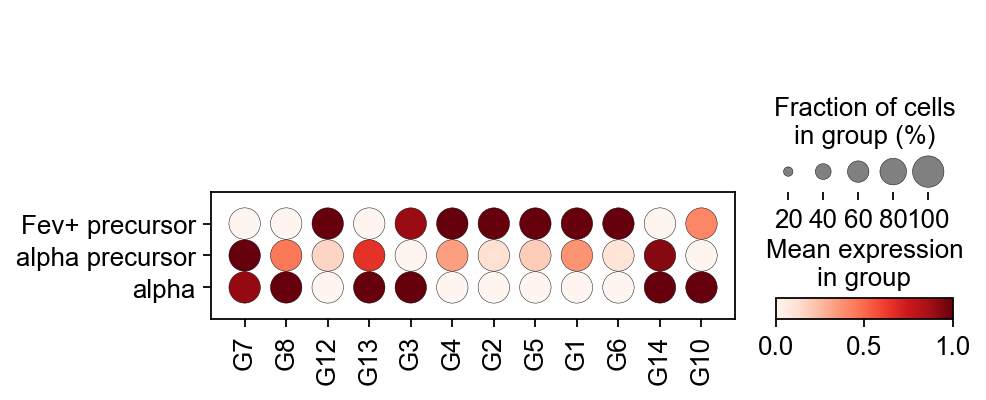

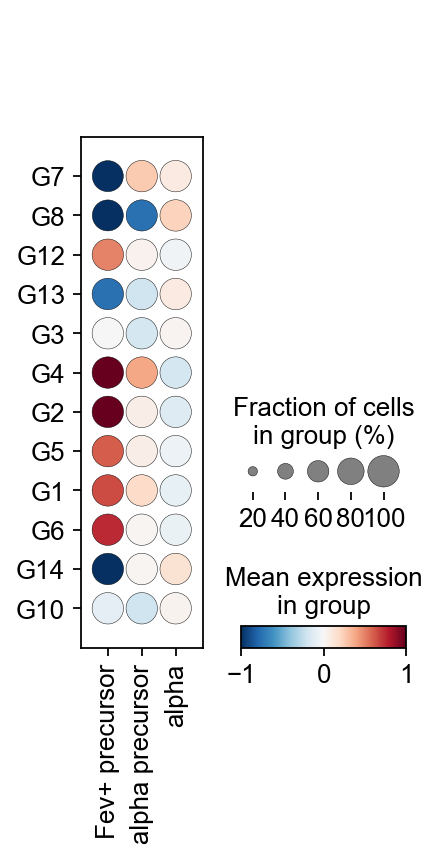

In [265]:
cao_fetal_g = sc.AnnData(cao_fetal_alpha.obs[['G7', 'G8', 'G12', 'G13', 'G3', 'G4', 'G2', 'G5', 'G1', 'G6', 'G14', 'G10']])
cao_fetal_g.obs = cao_fetal_alpha.obs
sc.pl.dotplot(cao_fetal_g, groupby='louvain_anno_broad', var_names=cao_fetal_g.var_names, standard_scale='var', dot_max=1, expression_cutoff=-0.5)
sc.pl.dotplot(sc.pp.scale(cao_fetal_g, copy=True), groupby='louvain_anno_broad', var_names=cao_fetal_g.var_names,  
              expression_cutoff=-3, vmax=1, vmin=-1, cmap='RdBu_r', swap_axes=True)

### Marker expression

In [438]:
gc_dict = {
    'endocrine identity/\nmaturation': ['FEV', 'NKX2-2', 'NEUROD1', 'ARX', 'ISL1', 'LOXL4', 'WNT4'],
    'developmental\nfactors': ['SOX4', 'SOX11', 'NRG1', 'EPHB2', 'SPOCK1'],
    'growth factors/\nhormones': ['VEGFC', 'IGF2BP2', 'IGF2', 'NPY'],
    'TGFB\nsignaling': ['TGFBR1', 'TGFBR2', 'TGFB1', 'SMAD3', 'SMAD5', 'SMAD7', 'SMAD9', 'ID1', 'ID2', 'ID3', 'TNC', 'MYC', 'CDH6']}

In [439]:
genes = []
for k,v in gc_dict.items():
    genes = genes + v

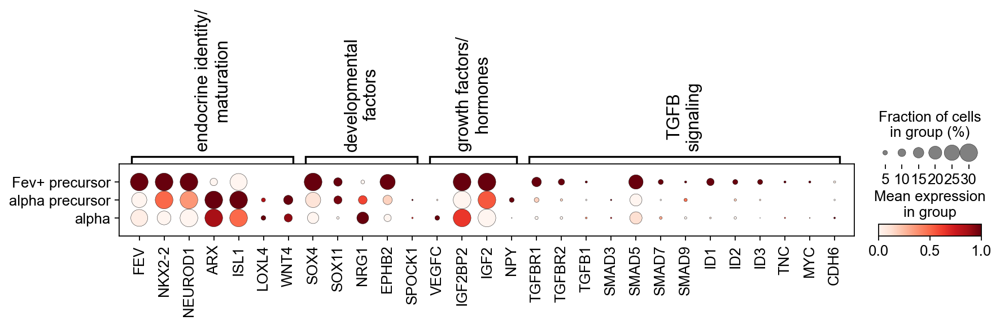

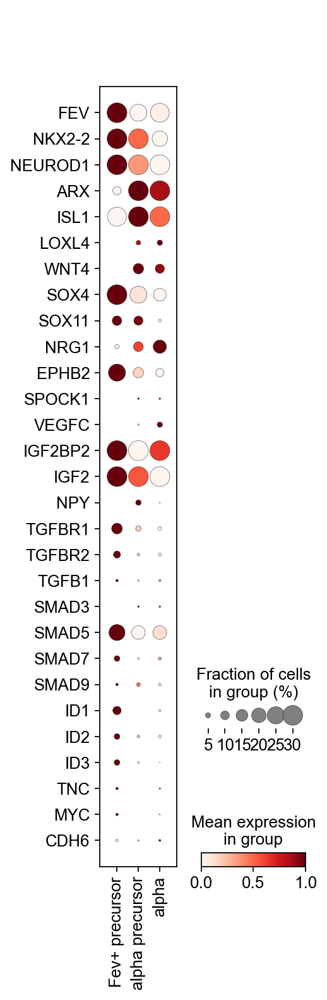

In [440]:
sc.pl.dotplot(cao_fetal_alpha, groupby='louvain_anno_broad',
                 var_names=gc_dict,dot_max=0.3,
                 standard_scale='var')
sc.pl.dotplot(cao_fetal_alpha, groupby='louvain_anno_broad',
                 var_names=genes, dot_max=0.3,
                 standard_scale='var', swap_axes=True)

### Yu 2021

data curated in curate_fetal_Yu_2021.ipynb

In [4]:
yu_fetal = sc.read('./data/yu_endo.h5ad')

In [5]:
mk_human = pd.read_excel('../human_islets_notebooks/data/output_files/gene_sets_alpha.xlsx')

In [7]:
# map gene set scores
for i in mk_human.columns:
    sc.settings.verbosity=0
    genes = mk_human[i].dropna().tolist()
    sc.tl.score_genes(yu_fetal, gene_list=genes, score_name=f'G{i}')

In [8]:
obs_g = ['G7', 'G8', 'G12', 'G13', 'G3', 'G4', 'G2', 'G5', 'G1', 'G6', 'G14', 'G10']

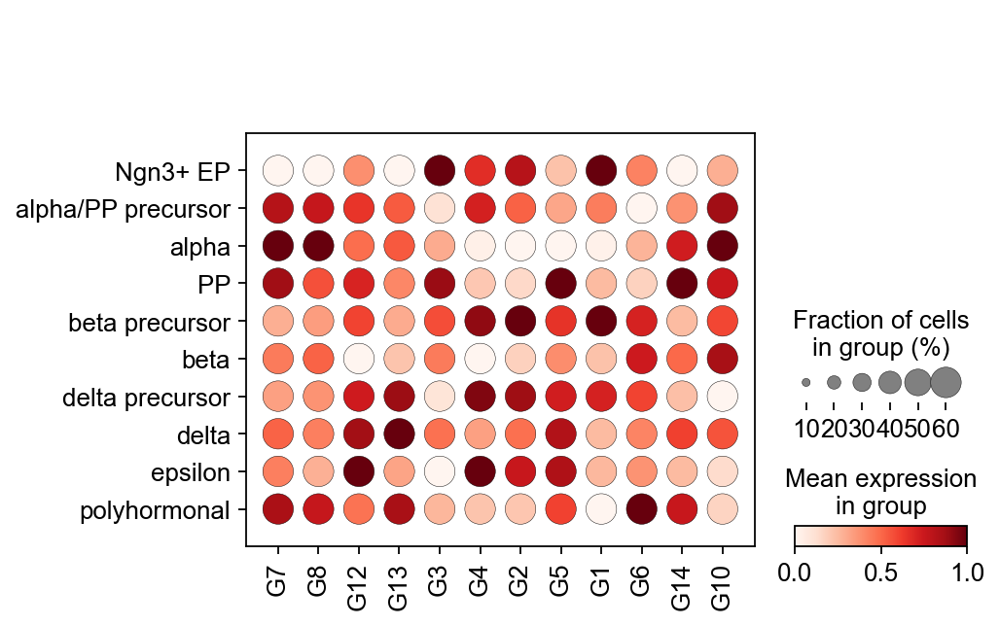

In [9]:
adata_yu_g = sc.AnnData(yu_fetal.obs[obs_g])
adata_yu_g.obs = yu_fetal.obs
sc.pl.dotplot(adata_yu_g, groupby='louvain_anno', var_names=adata_yu_g.var_names, dot_max=0.6, expression_cutoff=-1, standard_scale='var')

In [10]:
# subset to beta cell lineage
yu_alpha = yu_fetal[yu_fetal.obs.louvain_anno.isin(['Ngn3+ EP', 'alpha/PP precursor', 'alpha'])].copy()

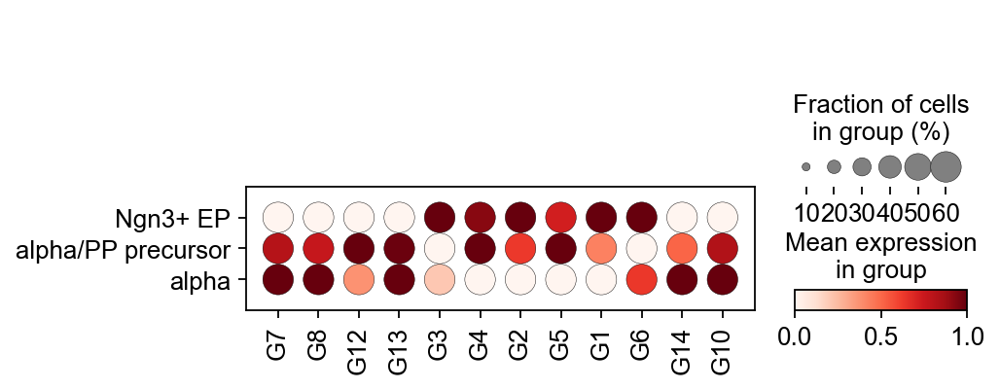

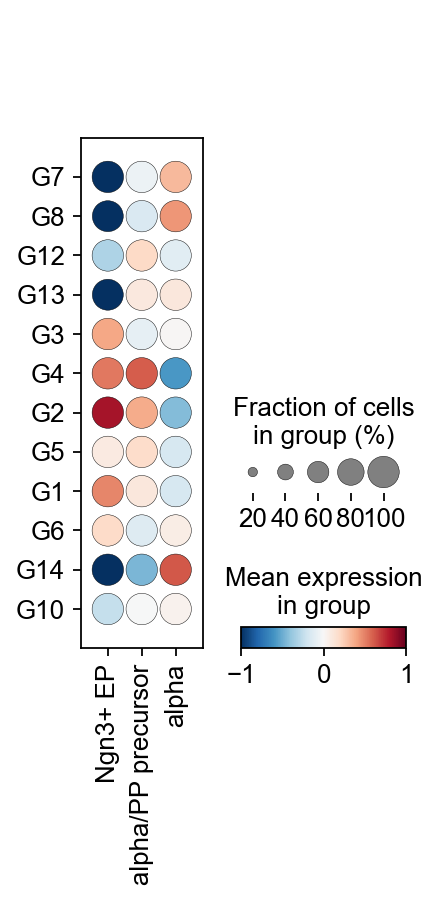

In [11]:
alpha_yu_g = sc.AnnData(yu_alpha.obs[obs_g])
alpha_yu_g.obs = yu_alpha.obs
sc.pl.dotplot(alpha_yu_g, groupby='louvain_anno', var_names=alpha_yu_g.var_names, dot_max=0.6, expression_cutoff=-1, standard_scale='var')
sc.pl.dotplot(sc.pp.scale(alpha_yu_g, copy=True), groupby='louvain_anno', var_names=alpha_yu_g.var_names, swap_axes=True,  expression_cutoff=-3, vmax=1, vmin=-1, cmap='RdBu_r')

In [12]:
gc_dict = {
    'endocrine identity/\nmaturation': ['FEV', 'NKX2-2', 'NEUROD1', 'ARX', 'ISL1', 'LOXL4', 'WNT4'],
    'developmental\nfactors': ['SOX4', 'SOX11', 'NRG1', 'EPHB2', 'SPOCK1'],
    'growth factors/\nhormones': ['VEGFC', 'IGF2BP2', 'IGF2', 'NPY'],
    'TGFB\nsignaling': ['TGFBR1', 'TGFBR2', 'TGFB1', 'SMAD3', 'SMAD5', 'SMAD7', 'SMAD9', 'ID1', 'ID2', 'ID3', 'TNC', 'MYC', 'CDH6']}

In [13]:
genes = []
for k,v in gc_dict.items():
    genes = genes + v

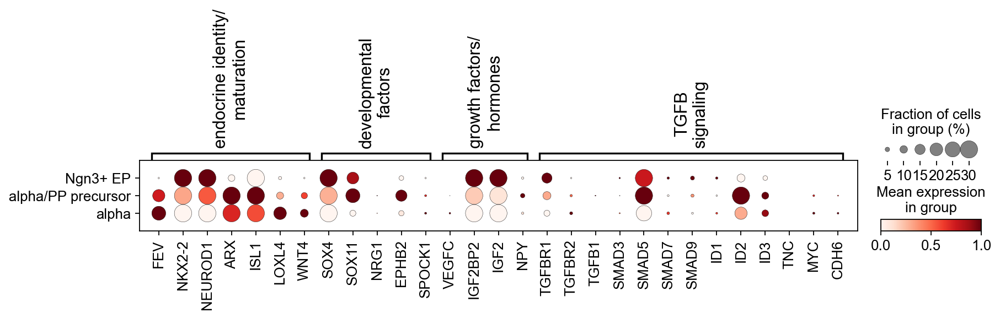

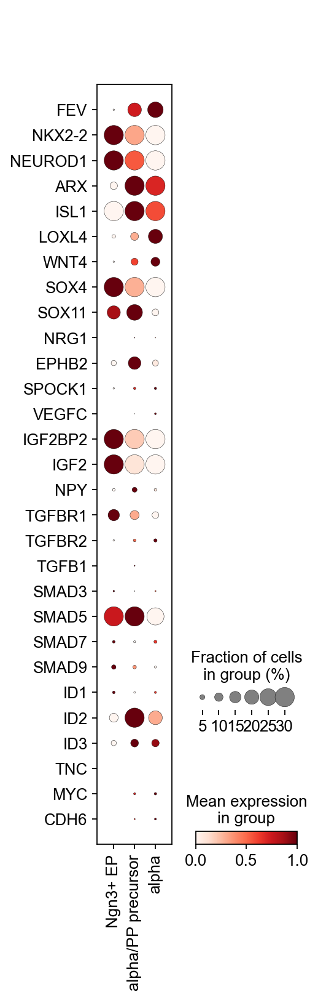

In [15]:
sc.pl.dotplot(yu_alpha, groupby='louvain_anno',
                 var_names=gc_dict,dot_max=0.3,
                 standard_scale='var')
sc.pl.dotplot(yu_alpha, groupby='louvain_anno',
                 var_names=genes, dot_max=0.3,
                 standard_scale='var', swap_axes=True)